# Config

In [1]:
!pip install pydicom -q

In [2]:
import seaborn as sns
from collections import Counter

import matplotlib.pyplot as plt
import os
import time
import numpy as np
import collections

import pydicom as dicom
import matplotlib.patches as patches

from matplotlib import animation, rc
import pandas as pd

import pydicom as dicom # dicom
import pydicom
# from pydicom.pixel_data_handlers.util import apply_voi_lut

In [3]:
PROJECT_DIR = '/home/jupyter'

# Read, inspect and process metadata

In [4]:
DATA_DIR = os.path.join(PROJECT_DIR, 'data')

train       = pd.read_csv(os.path.join(DATA_DIR, 'train.csv'))
train_desc  = pd.read_csv(os.path.join(DATA_DIR, 'train_series_descriptions.csv'))
train_label = pd.read_csv(os.path.join(DATA_DIR, 'train_label_coordinates.csv'))

## Metadata processing

In [5]:
# Define function to reshape a single row of the DataFrame
def reshape_row(row):
    data = {'study_id': [], 'condition': [], 'level': [], 'severity': []}
    
    for column, value in row.items():
        if column not in ['study_id', 'series_id', 'instance_number', 'x', 'y', 'series_description']:
            parts = column.split('_')
            condition = ' '.join([word.capitalize() for word in parts[:-2]])
            level = parts[-2].capitalize() + '/' + parts[-1].capitalize()
            data['study_id'].append(row['study_id'])
            data['condition'].append(condition)
            data['level'].append(level)
            data['severity'].append(value)
    
    return pd.DataFrame(data)

# Reshape the DataFrame for all rows
new_train_df = pd.concat([reshape_row(row) for _, row in train.iterrows()], ignore_index=True)

In [6]:
merged_df = pd.merge(new_train_df, train_label, on=['study_id', 'condition', 'level'], how='inner')

In [7]:
final_merged_df = pd.merge(merged_df, train_desc, on=['series_id','study_id'], how='inner')
final_merged_df['image_path'] = [os.path.join(DATA_DIR, 'train_images',
                                             str(final_merged_df.study_id[i]), 
                                             str(final_merged_df.series_id[i]), 
                                             str(final_merged_df.instance_number[i]) + '.dcm') for i in range(final_merged_df.shape[0])]

In [8]:
final_merged_df.sample(n = 10)

,study_id,condition,level,severity,series_id,instance_number,x,y,series_description,image_path
46646,4117229032,Left Neural Foraminal Narrowing,L2/L3,Normal/Mild,2804161657,14,151.168758,143.441397,Sagittal T1,/home/jupyter/data/train_images/4117229032/280...
2536,215149692,Spinal Canal Stenosis,L4/L5,Normal/Mild,2429010885,14,406.446073,504.342940,Sagittal T2/STIR,/home/jupyter/data/train_images/215149692/2429...
40626,3562838732,Left Neural Foraminal Narrowing,L3/L4,Normal/Mild,2243673732,10,256.298326,261.065449,Sagittal T1,/home/jupyter/data/train_images/3562838732/224...
44975,3955843496,Left Neural Foraminal Narrowing,L3/L4,Normal/Mild,273282509,12,264.215321,263.469979,Sagittal T1,/home/jupyter/data/train_images/3955843496/273...
42482,3740680860,Left Neural Foraminal Narrowing,L2/L3,Moderate,955666461,5,185.547862,178.118126,Sagittal T1,/home/jupyter/data/train_images/3740680860/955...
14128,1268470656,Right Subarticular Stenosis,L2/L3,Normal/Mild,3185733973,6,296.663202,335.966736,Axial T2,/home/jupyter/data/train_images/1268470656/318...
13399,1195410745,Left Subarticular Stenosis,L2/L3,Normal/Mild,3558150482,10,201.142857,192.108108,Axial T2,/home/jupyter/data/train_images/1195410745/355...
17115,1531615123,Left Neural Foraminal Narrowing,L3/L4,Normal/Mild,2642013991,13,260.729378,271.189580,Sagittal T1,/home/jupyter/data/train_images/1531615123/264...
37820,3331954682,Spinal Canal Stenosis,L4/L5,Moderate,458140319,8,333.570451,399.233926,Sagittal T2/STIR,/home/jupyter/data/train_images/3331954682/458...
42778,3768387090,Spinal Canal Stenosis,L3/L4,Normal/Mild,2448118532,10,223.750483,231.580595,Sagittal T2/STIR,/home/jupyter/data/train_images/3768387090/244...


### Remove rows with missing label

In [9]:
na_info = pd.DataFrame({
    'Missing Values': final_merged_df.isna().sum(),
    'Percentage': (final_merged_df.isna().sum() / len(final_merged_df) * 100).round(2),
    'Total Rows': len(final_merged_df),
    'Dtype': final_merged_df.dtypes
})
print(na_info)

                    Missing Values  Percentage  Total Rows    Dtype
study_id                         0        0.00       48692    int64
condition                        0        0.00       48692   object
level                            0        0.00       48692   object
severity                        35        0.07       48692   object
series_id                        0        0.00       48692    int64
instance_number                  0        0.00       48692    int64
x                                0        0.00       48692  float64
y                                0        0.00       48692  float64
series_description               0        0.00       48692   object
image_path                       0        0.00       48692   object


In [10]:
final_merged_df = final_merged_df.dropna()

### Keep only one coordinate per level per image (i.e. multiple coordinates) to avoid model confusion

In [11]:
duplicates = final_merged_df.duplicated(subset=['study_id', 'series_id', 'instance_number', 'level'])
duplicate_rows = final_merged_df[duplicates]
duplicate_rows.head(5)

,study_id,condition,level,severity,series_id,instance_number,x,y,series_description,image_path
21,4003253,Right Subarticular Stenosis,L2/L3,Normal/Mild,2448190387,11,145.900042,157.096466,Axial T2,/home/jupyter/data/train_images/4003253/244819...
22,4003253,Right Subarticular Stenosis,L3/L4,Normal/Mild,2448190387,19,142.843690,156.179561,Axial T2,/home/jupyter/data/train_images/4003253/244819...
23,4003253,Right Subarticular Stenosis,L4/L5,Normal/Mild,2448190387,28,147.428218,158.013372,Axial T2,/home/jupyter/data/train_images/4003253/244819...
24,4003253,Right Subarticular Stenosis,L5/S1,Normal/Mild,2448190387,35,145.900042,161.375358,Axial T2,/home/jupyter/data/train_images/4003253/244819...
46,4646740,Right Subarticular Stenosis,L2/L3,Moderate,3201256954,22,200.977376,256.868778,Axial T2,/home/jupyter/data/train_images/4646740/320125...


#### Analyze components of duplicated rows

In [12]:
duplicate_rows['condition'].value_counts()

condition
Right Subarticular Stenosis         5457
Right Neural Foraminal Narrowing      39
Name: count, dtype: int64

In [13]:
duplicate_rows['series_description'].value_counts()

series_description
Axial T2       5457
Sagittal T1      39
Name: count, dtype: int64

In [14]:
duplicate_rows['severity'].value_counts()

severity
Normal/Mild    3921
Moderate       1049
Severe          526
Name: count, dtype: int64

#### Remove these duplicated rows

In [15]:
final_merged_df = final_merged_df[~duplicates]

## Encode categorical variables

In [16]:
LEVEL_LABELS = {
    "L1/L2": 1,
    "L2/L3": 2,
    "L3/L4": 3,
    "L4/L5": 4,
    "L5/S1": 5
}
SEVERITY_LABELS = {
    "Normal/Mild": 0,
    "Moderate": 1,
    "Severe": 2
}

In [17]:
final_merged_df['level_code']    = final_merged_df['level'].map(LEVEL_LABELS)
final_merged_df['severity_code'] = final_merged_df['severity'].map(SEVERITY_LABELS)

In [18]:
final_merged_df.head()

,study_id,condition,level,severity,series_id,instance_number,x,y,series_description,image_path,level_code,severity_code
0,4003253,Spinal Canal Stenosis,L1/L2,Normal/Mild,702807833,8,322.831858,227.964602,Sagittal T2/STIR,/home/jupyter/data/train_images/4003253/702807...,1,0
1,4003253,Spinal Canal Stenosis,L2/L3,Normal/Mild,702807833,8,320.571429,295.714286,Sagittal T2/STIR,/home/jupyter/data/train_images/4003253/702807...,2,0
2,4003253,Spinal Canal Stenosis,L3/L4,Normal/Mild,702807833,8,323.030303,371.818182,Sagittal T2/STIR,/home/jupyter/data/train_images/4003253/702807...,3,0
3,4003253,Spinal Canal Stenosis,L4/L5,Normal/Mild,702807833,8,335.292035,427.327434,Sagittal T2/STIR,/home/jupyter/data/train_images/4003253/702807...,4,0
4,4003253,Spinal Canal Stenosis,L5/S1,Normal/Mild,702807833,8,353.415929,483.964602,Sagittal T2/STIR,/home/jupyter/data/train_images/4003253/702807...,5,0


## Write out processed metadata table for future usage

In [19]:
write_dir = os.path.join(PROJECT_DIR, 'data', 'processed_metadata')
os.makedirs(write_dir, exist_ok=True)

In [20]:
final_merged_df.to_csv(os.path.join(write_dir, 'processed_metadata.csv'), index=False)

In [96]:
condition_types = final_merged_df['condition'].unique().tolist()
for condition in condition_types:
    df = final_merged_df[(final_merged_df['condition'] == condition)]
    df.to_csv(os.path.join(write_dir, 'processed_metadata_' + condition.replace(" ", "") + '.csv'),
              index=False)

## Data Format after procecessing

<div style="font-size: 16px;">
    Columns in the metadata:
    <ul>
<!--         <li>'study_id':  Each patient has a <i>study</i>.
        <li>'condition':  Illness condition. 
        <li>'level': Each image/instance might capture multiple lumbar spine <i>levels</i> (e.g., L1/L2, L2/L3, ..., L5/S1). 
        <li>'severity': Each label describes the severity classification of a lumbar spine level.
        <li>'series_id': That study has 3 <i>series</i>.
        <li>'instance_number': Within a series you have multiple <i>images/instances</i>.
        <li>'series_description': MRI image type. Multiple series might maps to the same MRI image type. -->
         <li><strong>study_id</strong>: A unique identifier for each medical examination/study (e.g., 4096820034), used to group related images from the same patient visit.
         <li><strong>condition</strong>: The diagnosed spinal condition, such as "Spinal Canal Stenosis" or "Left Neural Foraminal Narrowing", indicating the specific pathology identified.
         <li><strong>level</strong>: Indicates the specific vertebral levels involved (e.g., L1/L2, L2/L3, etc.), where 'L' represents lumbar vertebrae. The notation shows which adjacent vertebrae are affected.
         <li><strong>severity</strong>: Describes the degree of the condition (e.g., Normal/Mild), helping clinicians assess the progression of the disease.
         <li><strong>series_id</strong>: A unique identifier for a specific series of images (e.g., 2602265508) within a study, typically representing different imaging sequences or views.
         <li><strong>instance_number</strong>: A numerical identifier (e.g., 7, 5, 4) indicating the image's position within a series.
         <li><strong>x, y</strong>: Coordinate values indicating specific locations in the images, likely used for annotation or measurement purposes.
         <li><strong>series_description</strong>: Describes the type of imaging sequence used (e.g., "Sagittal T2/STIR" or "Sagittal T1"), where:
             <ul>   
                 <li><strong>Sagittal</strong> refers to the imaging plane (side view)
                 <li><strong>T1 and T2</strong> refer to different MRI weighted sequences
                 <li><strong>STIR</strong> (Short TI Inversion Recovery) is a fat-suppression technique used to highlight pathology
             </ul>
    </ul>
<div>

### Example: study 4096820034

<div style="font-size: 16px;">
    As we may observe from the following example patient:
    <ul>
        <li>One series corresponds to one image type (i.e., Sagittal T2/STIR, Axial T2, or Sagittal T1).</li>
        <li>Each type of imaging sequence was used to diagnose a condition:
            <ul>   
                 <li><strong>Sagittal T2/STIR</strong> is used to diagnose <strong>Spinal Canal Stenosis</strong>
                 <li><strong>Sagittal T1</strong> is used to diagnose <strong>Neural Foraminal Narrowing</strong>
                 <li><strong>Axial T2</strong> is used to diagnose <strong>Subarticular Stenosis</strong>
             </ul>
        <li>Not all DICOM images has labels; and one image might have multiple labels, one of each spine level.</li>
    </ul>
<div>

In [22]:
final_merged_df[final_merged_df.study_id == 4096820034]

,study_id,condition,level,severity,series_id,instance_number,x,y,series_description,image_path,level_code,severity_code
46392,4096820034,Spinal Canal Stenosis,L1/L2,Normal/Mild,2602265508,7,268.706316,88.525822,Sagittal T2/STIR,/home/jupyter/data/train_images/4096820034/260...,1,0
46393,4096820034,Spinal Canal Stenosis,L2/L3,Normal/Mild,2602265508,7,257.288476,135.399061,Sagittal T2/STIR,/home/jupyter/data/train_images/4096820034/260...,2,0
46394,4096820034,Spinal Canal Stenosis,L3/L4,Normal/Mild,2602265508,7,247.673452,180.469484,Sagittal T2/STIR,/home/jupyter/data/train_images/4096820034/260...,3,0
46395,4096820034,Spinal Canal Stenosis,L4/L5,Normal/Mild,2602265508,7,244.668757,220.732394,Sagittal T2/STIR,/home/jupyter/data/train_images/4096820034/260...,4,0
46396,4096820034,Spinal Canal Stenosis,L5/S1,Normal/Mild,2602265508,7,253.081903,260.394366,Sagittal T2/STIR,/home/jupyter/data/train_images/4096820034/260...,5,0
46397,4096820034,Left Neural Foraminal Narrowing,L1/L2,Normal/Mild,3236751045,5,213.127193,70.175439,Sagittal T1,/home/jupyter/data/train_images/4096820034/323...,1,0
46398,4096820034,Left Neural Foraminal Narrowing,L2/L3,Normal/Mild,3236751045,4,208.074561,110.035088,Sagittal T1,/home/jupyter/data/train_images/4096820034/323...,2,0
46399,4096820034,Left Neural Foraminal Narrowing,L3/L4,Normal/Mild,3236751045,4,200.214912,147.649123,Sagittal T1,/home/jupyter/data/train_images/4096820034/323...,3,0
46400,4096820034,Left Neural Foraminal Narrowing,L4/L5,Normal/Mild,3236751045,4,193.478070,186.947368,Sagittal T1,/home/jupyter/data/train_images/4096820034/323...,4,0
46401,4096820034,Left Neural Foraminal Narrowing,L5/S1,Normal/Mild,3236751045,3,193.478070,222.877193,Sagittal T1,/home/jupyter/data/train_images/4096820034/323...,5,0


## Summary stats of the dataset

### Total number of patients/studies

In [23]:
print(f"Number of patients/studies in training set: {final_merged_df['study_id'].nunique()}\n")

Number of patients/studies in training set: 1974



### Total number of series

In [24]:
print(f"Number of series in training set: {final_merged_df['series_id'].nunique()}\n")

Number of series in training set: 6290



### Number of series per study

Counter({3: 1634, 4: 307, 5: 30, 2: 2, 6: 1})


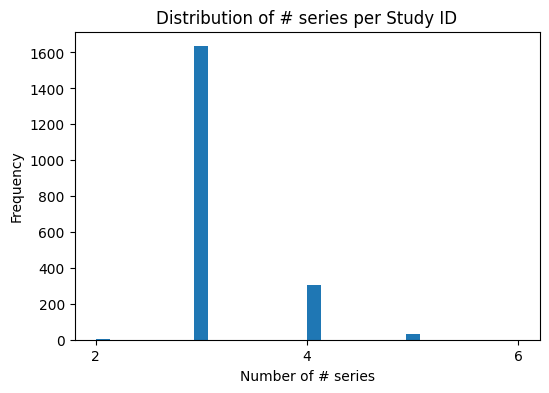

In [25]:
counts = final_merged_df.groupby('study_id')['series_id'].nunique()
print(Counter(counts))

plt.figure(figsize=(6, 4))
plt.hist(counts, bins=30)
plt.title('Distribution of # series per Study ID')
plt.xlabel('Number of # series')
plt.ylabel('Frequency')
plt.xticks(range(min(counts), max(counts) + 1, 2))  # Step by 2 for less crowding
plt.show()

### Total number of labels

In [26]:
print(f"Number of annotated labels/spine levels in training set: {final_merged_df.shape[0]}\n")

Number of annotated labels/spine levels in training set: 43161



### Distribution of diagnosed spinal condition

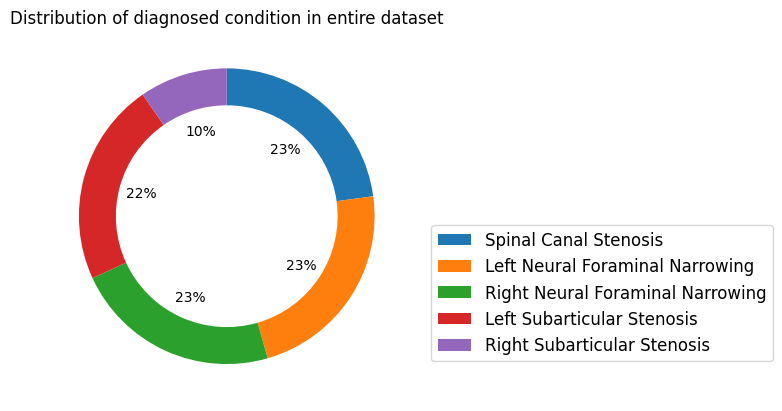

In [27]:
name = final_merged_df['condition'].unique().tolist()
plt.pie(final_merged_df['condition'].value_counts(normalize=True), 
        autopct='%1.f%%', 
        startangle=90, 
        wedgeprops=dict(width=0.25), 
        labeldistance=1.2, 
        counterclock=False, radius=1)
plt.title(f'Distribution of diagnosed condition in entire dataset')
plt.legend(name, bbox_to_anchor=(2, 0.5), prop={'size': 12}, markerscale = 3, framealpha=0.8, facecolor='white')

### Distribution of labels

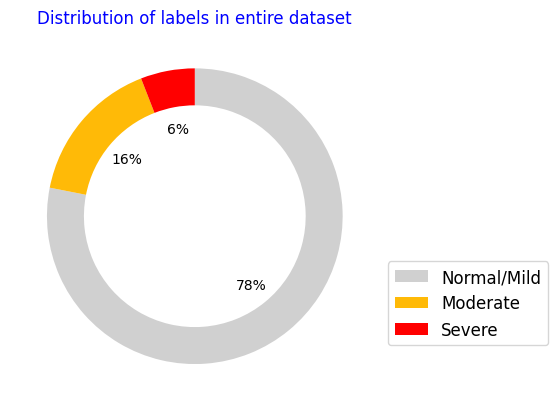

In [28]:
name = ['Normal/Mild', 'Moderate', 'Severe']
p=['#d0d0d0', '#ffba07', '#ff0000']
plt.pie(final_merged_df.severity.value_counts(normalize=True), 
        autopct = '%1.f%%', 
        colors = sns.color_palette(p), 
        startangle=90, 
        wedgeprops=dict(width=0.25), 
        labeldistance=1.2, 
        counterclock=False, radius=1)
plt.title(f'Distribution of labels in entire dataset', color='blue')
plt.legend(name, bbox_to_anchor=(1, 0.4), prop={'size': 12}, markerscale = 3, framealpha=0.8, facecolor='white')

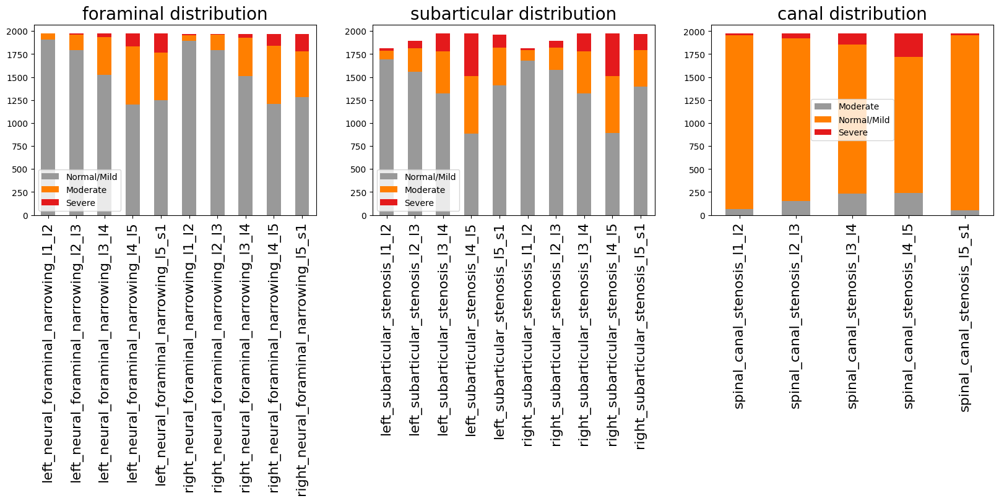

In [29]:
fig, axes = plt.subplots(1, 3, figsize=(20, 4))
colours = {"male": "#273c75", "female": "#44bd32"}
for idx, d in enumerate(['foraminal', 'subarticular', 'canal']):
    diagnosis = list(filter(lambda x: x.find(d) > -1, train.columns))
    dff = train[diagnosis]
    value_counts = dff.apply(pd.value_counts).fillna(0).T
    value_counts.plot(kind='bar', stacked=True, ax=axes[idx], cmap='Set1_r')
    axes[idx].tick_params(axis='x', labelsize=16) 
    axes[idx].set_title(f"{d} distribution",  fontsize=20)

Counter({2: 3960, 1: 2330, 3: 1})


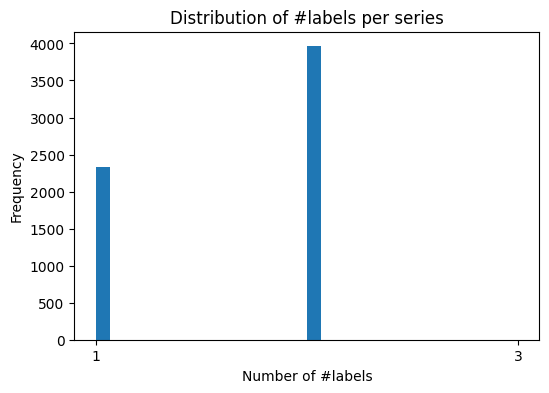

In [30]:
counts = train_label.groupby('series_id')['condition'].nunique()
print(Counter(counts))

plt.figure(figsize=(6, 4))
plt.hist(counts, bins=30)
plt.title('Distribution of #labels per series')
plt.xlabel('Number of #labels')
plt.ylabel('Frequency')
plt.xticks(range(min(counts), max(counts) + 1, 2))  # Step by 2 for less crowding
plt.show()

## Display images for the example patient/study 4096820034

### Set study ID

In [31]:
study_id = 4096820034
series_ids = final_merged_df['series_id'][final_merged_df['study_id'] == 4096820034].unique().tolist()

## Descriptions corresponds to each series
final_merged_df[['study_id', 'series_id', 'series_description']][final_merged_df.study_id == 4096820034].groupby('series_id').first().reindex(series_ids)

,study_id,series_description
series_id,,
2602265508,4096820034,Sagittal T2/STIR
3236751045,4096820034,Sagittal T1
2097107888,4096820034,Axial T2
3114813181,4096820034,Axial T2
2679683906,4096820034,Axial T2
300517765,4096820034,Axial T2


### Plot all available DICOM images for this patient

In [32]:
image_dir = os.path.join(DATA_DIR, 'train_images')

# Function to generate image paths based on directory structure
def generate_image_paths(study_id, series_id):
    
    series_dir = os.path.join(image_dir, str(study_id), str(series_id))
    images = sorted(os.listdir(series_dir))
    image_paths = [os.path.join(series_dir, img) for img in images]
    
    return image_paths

# Function to open and display DICOM images
def display_dicom_images(image_paths):
    
    n_images = len(image_paths)
    n_cols = 3
    n_rows = (n_images - 1) // n_cols + 1
    
    plt.figure(figsize=(5*n_cols, 5*n_rows))  
    for i, path in enumerate(image_paths):
        ds = pydicom.dcmread(path)
        plt.subplot(n_rows, n_cols, i+1)
        plt.imshow(ds.pixel_array, cmap=plt.cm.bone)
        plt.title(f"Image {path.split('/')[-1]}")
        plt.axis('off')
    plt.show()

#### Display Sagittal T2/STIR images

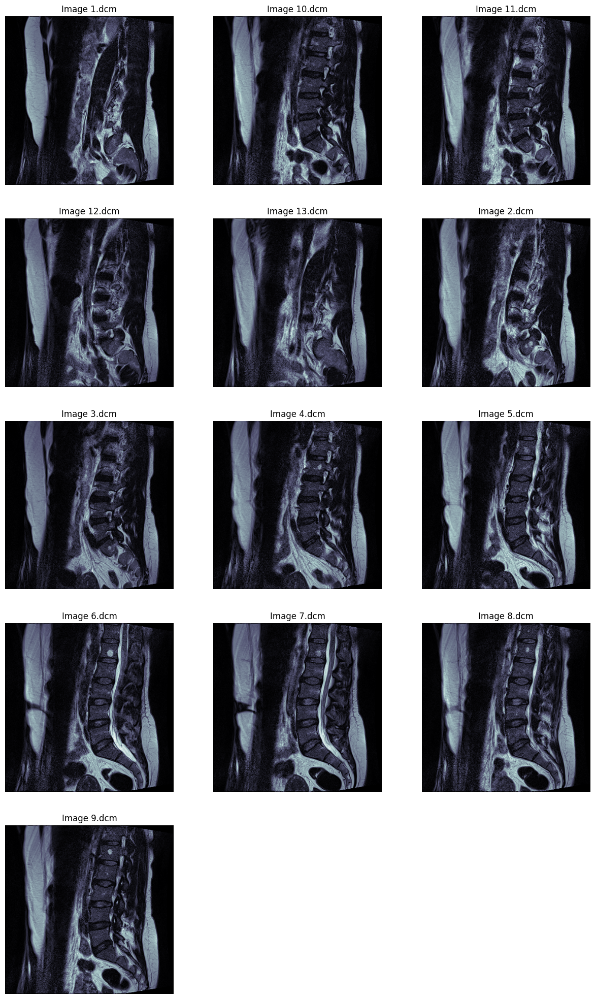

In [33]:
image_paths = generate_image_paths(study_id, series_ids[0])
display_dicom_images(image_paths)

#### Display Sagittal T1 images

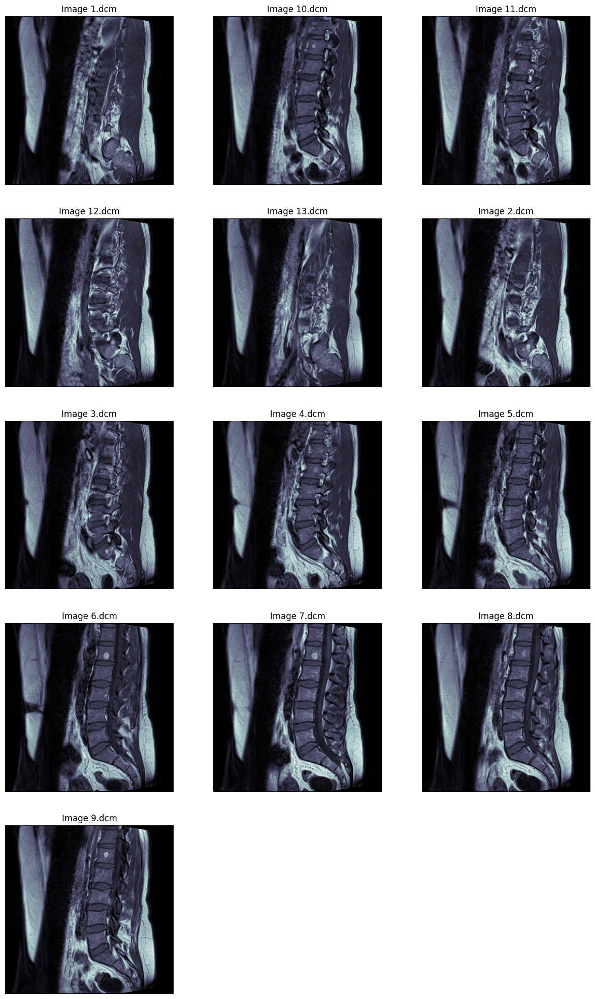

In [34]:
image_paths = generate_image_paths(study_id, series_ids[1])
display_dicom_images(image_paths)

#### Display Axial T2 images, first series

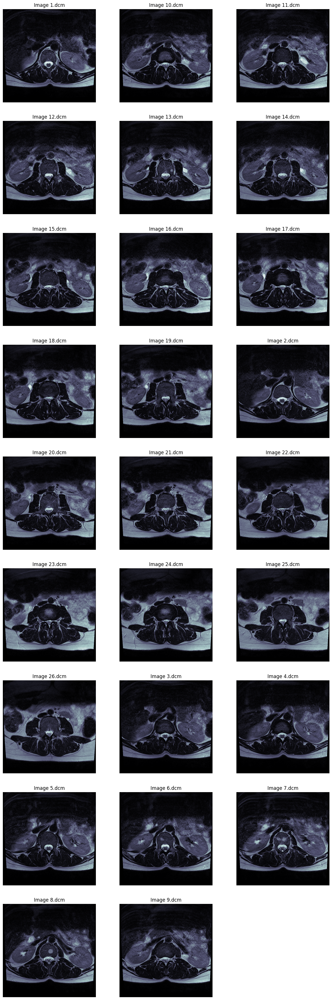

In [35]:
image_paths = generate_image_paths(study_id, series_ids[2])
display_dicom_images(image_paths)

#### Display Axial T2 images, second series

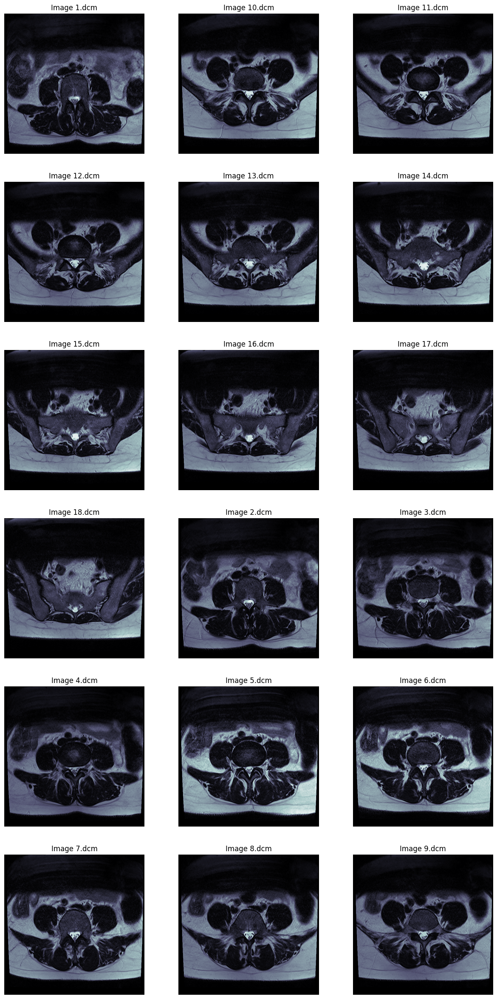

In [36]:
image_paths = generate_image_paths(study_id, series_ids[3])
display_dicom_images(image_paths)

### Plot DICOM images with annotated coordinates for this patient

In [90]:
# Function to open and display DICOM images along with coordinates
def display_dicom_with_coordinates(image_paths, train_label_df):

    fig, axs = plt.subplots(len(image_paths), 1, figsize=(8, 6*len(image_paths)))
    
    for idx, path in enumerate(image_paths):  # Display images
        study_id = int(path.split('/')[-3])
        series_id = int(path.split('/')[-2])
        instance_number = int(path.split('/')[-1].split('.')[0])
        series_desc = train_label_df['series_description'][(train_label_df['study_id'] == study_id) & 
                                                           (train_label_df['series_id'] == series_id) &
                                                           (train_label_df['instance_number'] == instance_number)].unique()
        
        # Filter train_label coordinates for the current study and series
        filtered_train_labels = train_label_df[(train_label_df['study_id'] == study_id) & 
                                               (train_label_df['series_id'] == series_id) &
                                               (train_label_df['instance_number'] == instance_number)]
        
        # print(study_id, series_id, instance_number, series_desc, filtered_train_labels)
        
        # Read DICOM image
        ds = pydicom.dcmread(path)
        
        # Plot DICOM image
        axs[idx].imshow(ds.pixel_array, cmap='gray')
        axs[idx].set_title(f"Study ID: {study_id}, Series ID: {series_id} ({series_desc[0]})")
        axs[idx].axis('off')
        
        # Plot coordinates
        for _, row in filtered_train_labels.iterrows():
            axs[idx].plot(row['x'], row['y'], 'ro', markersize=5)
            axs[idx].text(row['x']+8, row['y']+3, f"{row['level']} ({row['severity']} {row['condition']})", color='r',fontsize=10)
        
    plt.tight_layout()
    plt.show()

# Load DICOM files from a folder
def load_dicom_files(path_to_folder):
    
    files = [os.path.join(path_to_folder, f) for f in os.listdir(path_to_folder) if f.endswith('.dcm')]
    files.sort(key=lambda x: int(os.path.splitext(os.path.basename(x))[0].split('-')[-1]))
    
    return files

In [91]:
image_paths = final_merged_df['image_path'][final_merged_df['study_id'] == study_id].unique()

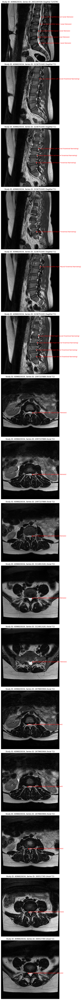

In [92]:
# Display DICOM images with coordinates
display_dicom_with_coordinates(image_paths, final_merged_df)

## Another example with severe condition

In [103]:
study_id_2 = 4279958262

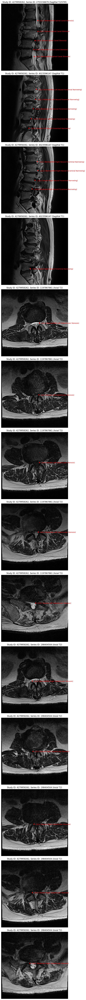

In [101]:
image_paths = final_merged_df['image_path'][final_merged_df['study_id'] == study_id_2].unique()
display_dicom_with_coordinates(image_paths, final_merged_df)